In [2]:
import scanpy as sc
import torch
import scarches as sca
from scarches.dataset.trvae.data_handling import remove_sparsity
import matplotlib.pyplot as plt
import numpy as np
import argparse
import anndata

In [3]:
adata_whole=sc.read("../../imporatant_process_data/4.12_wt_integrate_SCRAN_log1p.h5ad")



In [5]:
pip list

Package                  Version
------------------------ -----------
absl-py                  1.4.0
aiohttp                  3.8.3
aiosignal                1.3.1
anndata                  0.8.0
async-timeout            4.0.2
attrs                    22.2.0
backcall                 0.2.0
beautifulsoup4           4.11.2
biopython                1.79
blessed                  1.20.0
cached-property          1.5.2
certifi                  2021.10.8
charset-normalizer       2.1.1
chex                     0.1.6
click                    8.0.3
cloudpickle              2.2.1
contextlib2              21.6.0
cycler                   0.10.0
Cython                   0.29.24
debugpy                  1.5.1
decorator                5.1.0
Deprecated               1.2.13
distlib                  0.3.6
dm-tree                  0.1.8
docrep                   0.3.2
entrypoints              0.3
et-xmlfile               1.1.0
etils                    1.0.0
filelock                 3.9.0
fisher                

In [ ]:
vae = sca.models.SCVI(
    adata,
    n_latent=nlatent,
    encode_covariates=True,
    deeply_inject_covariates=False,
    )

In [7]:

hvg_n=2000
nlatent=10
unlabeled = adata_whole.obs.index[[ coarse_label != "Osteoblasts" for coarse_label in adata_whole.obs.coarse_label]]
adata_whole.obs['scanvi_label'] = adata_whole.obs.coarse_label.tolist()
adata_whole.obs.loc[unlabeled,'scanvi_label'] = "unlabeled"

condition_key = 'batch'
cell_type_key = 'scanvi_label'
unlabeled_category = "unlabeled"


# In[7]:



sc.pp.highly_variable_genes(adata_whole, batch_key="batch",min_mean=0.035, flavor="cell_ranger",n_top_genes=hvg_n)
adata = adata_whole[:,adata_whole.var.highly_variable].copy()
adata.X = adata.layers['counts']
adata.raw = adata
raw = adata.raw.to_adata()
raw.X = adata.layers['counts']
adata.raw = raw

/home/zhangyufeng/.local/lib/python3.9/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [8]:
adata.X[1:5,1:5].toarray()

array([[ 0.,  3.,  0.,  0.],
       [ 0.,  0.,  1.,  0.],
       [ 0.,  0.,  0.,  0.],
       [ 0.,  0., 14.,  0.]], dtype=float32)

In [13]:
sca.models.SCVI.setup_anndata(adata, batch_key=condition_key, labels_key=cell_type_key)
vae = sca.models.SCVI(
    adata,
    n_latent=nlatent,
    encode_covariates=True,
    deeply_inject_covariates=False,
    use_layer_norm="both",
    use_batch_norm="none",
    gene_likelihood="zinb",
    n_layers=1,
    dropout_rate=0.1
    )

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(


/home/zhangyufeng/.local/lib/python3.9/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
INFO:pytorch_lightning.utilities.rank_zero:GPU av

Epoch 1/56:   0%|          | 0/56 [00:00<?, ?it/s]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 56/56: 100%|██████████| 56/56 [14:48<00:00, 15.49s/it, loss=679, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=56` reached.


Epoch 56/56: 100%|██████████| 56/56 [14:48<00:00, 15.86s/it, loss=679, v_num=1]


/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(


INFO     Training for 10 epochs.                                                                                   


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3080') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/10:   0%|          | 0/10 [00:00<?, ?it/s]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 10/10: 100%|██████████| 10/10 [06:11<00:00, 37.01s/it, loss=667, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 10/10: 100%|██████████| 10/10 [06:11<00:00, 37.16s/it, loss=667, v_num=1]


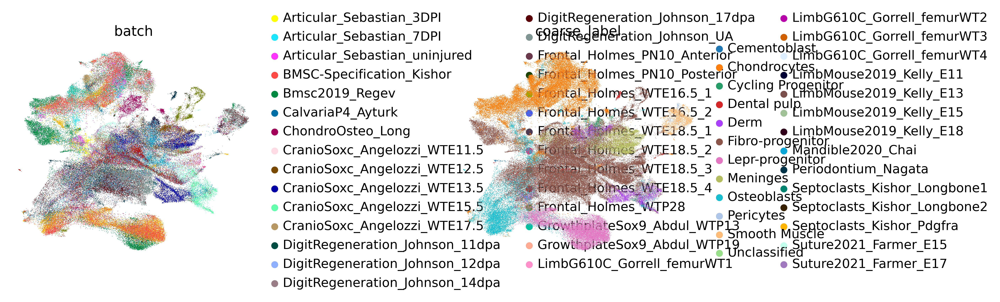

TypeError: write() missing 1 required positional argument: 'adata'

In [7]:

sc.pp.highly_variable_genes(adata_whole, batch_key="batch",min_mean=0.035, flavor="cell_ranger",n_top_genes=hvg_n)
adata = adata_whole[:,adata_whole.var.highly_variable].copy()
adata.X = adata.layers['counts']
adata.raw = adata
raw = adata.raw.to_adata()
raw.X = adata.layers['counts']
adata.raw = raw

vae.train()
scanvae = sca.models.SCANVI.from_scvi_model(vae, unlabeled_category =unlabeled_category)
scanvae.train(max_epochs=20)
reference_latent = sc.AnnData(scanvae.get_latent_representation())
reference_latent.obs["cell_type"] = adata.obs[cell_type_key].tolist()
reference_latent.obs["batch"] = adata.obs[condition_key].tolist()
reference_latent.obs["Project"] = adata.obs["Project"].tolist()
reference_latent.obs["coarse_label"] = adata.obs["coarse_label"].tolist()
sc.pp.neighbors(reference_latent, n_neighbors=8)
sc.tl.leiden(reference_latent)
sc.tl.umap(reference_latent)
sc.pl.umap(reference_latent,
    color=['batch', 'coarse_label'],
    frameon=False,
    wspace=0.6,save="gene_{}_latent_{}_umap".format(hvg_n, nlatent)
    )
reference_latent.write("../data/hypertune/gene_{}_latent_{}_umap.h5ad".format(hvg_n, nlatent))


In [12]:
def (hvg_n,nlatent):
    sc.pp.highly_variable_genes(adata_whole, batch_key="batch",min_mean=0.035, flavor="cell_ranger",n_top_genes=hvg_n)
    adata = adata_whole[:,adata_whole.var.highly_variable].copy()
    adata.X = adata.layers['counts']
    adata.raw = adata
    raw = adata.raw.to_adata()
    raw.X = adata.layers['counts']
    adata.raw = raw
    sca.models.SCVI.setup_anndata(adata, batch_key=condition_key, labels_key=cell_type_key)
    vae = sca.models.SCVI(
        adata,
        n_latent=nlatent,
        encode_covariates=True,
        deeply_inject_covariates=False,
        use_layer_norm="both",
        use_batch_norm="none",
        )
    vae.train()
    scanvae = sca.models.SCANVI.from_scvi_model(vae, unlabeled_category =unlabeled_category)
    scanvae.train(max_epochs=20)
    reference_latent = sc.AnnData(scanvae.get_latent_representation())
    reference_latent.obs["cell_type"] = adata.obs[cell_type_key].tolist()
    reference_latent.obs["batch"] = adata.obs[condition_key].tolist()
    reference_latent.obs["Project"] = adata.obs["Project"].tolist()
    reference_latent.obs["coarse_label"] = adata.obs["coarse_label"].tolist()
    sc.pp.neighbors(reference_latent, n_neighbors=8)
    sc.tl.leiden(reference_latent)
    sc.tl.umap(reference_latent)
    sc.pl.umap(reference_latent,
        color=['batch', 'coarse_label'],
        frameon=False,
        wspace=0.6,save="gene_{}_latent_{}_umap".format(hvg_n, nlatent)
        )
    reference_latent.write("../data/hypertune/gene_{}_latent_{}_umap.h5ad".format(hvg_n, nlatent))

In [13]:
import pandas as pd

In [19]:
hyperPara=pd.read_table("hyperPara",header=None)

In [20]:
hyperPara

,0,1
0,4000,20
1,1500,6
2,1000,15
3,2000,10
4,2000,30
5,5000,15
6,8000,4
7,3000,20
8,4000,4
9,1500,20


/home/zhangyufeng/.local/lib/python3.9/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
INFO:pytorch_lightning.utilities.rank_zero:GPU av

Epoch 1/56:   0%|          | 0/56 [00:00<?, ?it/s]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 56/56: 100%|██████████| 56/56 [15:42<00:00, 17.82s/it, loss=1.17e+03, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=56` reached.


Epoch 56/56: 100%|██████████| 56/56 [15:42<00:00, 16.83s/it, loss=1.17e+03, v_num=1]


/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(


INFO     Training for 20 epochs.                                                                                   


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3080') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/20:   0%|          | 0/20 [00:00<?, ?it/s]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 20/20: 100%|██████████| 20/20 [12:58<00:00, 40.39s/it, loss=1.16e+03, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|██████████| 20/20 [12:58<00:00, 38.93s/it, loss=1.16e+03, v_num=1]


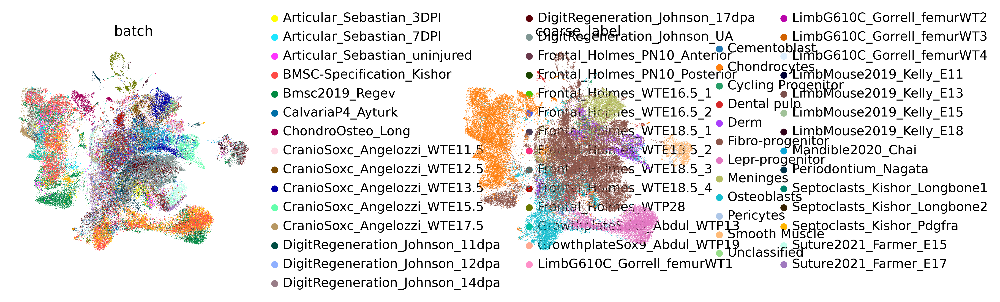

/home/zhangyufeng/.local/lib/python3.9/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
INFO:pytorch_lightning.utilities.rank_zero:GPU av

Epoch 1/56:   0%|          | 0/56 [00:00<?, ?it/s]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 55/56:  96%|█████████▋| 54/56 [16:01<00:35, 17.54s/it, loss=550, v_num=1]INFO     Training for 20 epochs.                                                                                   


/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/pytorch_lightning/trainer/call.py:48: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3080') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('med

Epoch 1/20:   0%|          | 0/20 [00:00<?, ?it/s]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 5/20:  20%|██        | 4/20 [02:29<09:58, 37.42s/it, loss=547, v_num=1]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/pytorch_lightning/trainer/call.py:48: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


KeyboardInterrupt: 

In [37]:
for i in range(19):
    hypertune(hvg_n=hyperPara[0][i],nlatent=hyperPara[1][i])

In [35]:
hyperPara[1][2]

15

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3

Epoch 1/56:   0%|          | 0/56 [00:00<?, ?it/s]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 56/56: 100%|██████████| 56/56 [16:18<00:00, 17.14s/it, loss=681, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=56` reached.


Epoch 56/56: 100%|██████████| 56/56 [16:18<00:00, 17.47s/it, loss=681, v_num=1]


/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(


INFO     Training for 20 epochs.                                                                                   


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3080') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/20:   0%|          | 0/20 [00:00<?, ?it/s]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 20/20: 100%|██████████| 20/20 [14:17<00:00, 43.37s/it, loss=679, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|██████████| 20/20 [14:17<00:00, 42.85s/it, loss=679, v_num=1]


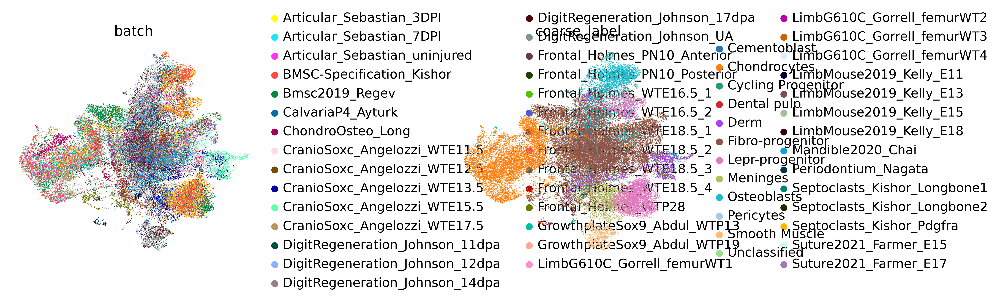

In [3]:

condition_key = 'batch'
cell_type_key = 'scanvi_label'
unlabeled_category = "unlabeled"
adata.X = adata.layers['counts']
adata.raw = adata
raw = adata.raw.to_adata()
raw.X = adata.layers['counts']
adata.raw = raw
sca.models.SCVI.setup_anndata(adata, batch_key=condition_key, labels_key=cell_type_key)
vae = sca.models.SCVI(
    adata,
    n_layers=2,
    encode_covariates=True,
    deeply_inject_covariates=False,
    use_layer_norm="both",
    use_batch_norm="none",
    
    )
vae.train()
scanvae = sca.models.SCANVI.from_scvi_model(vae, unlabeled_category =unlabeled_category)
scanvae.train(max_epochs=20)
reference_latent = sc.AnnData(scanvae.get_latent_representation())
reference_latent.obs["cell_type"] = adata.obs[cell_type_key].tolist()
reference_latent.obs["batch"] = adata.obs[condition_key].tolist()
reference_latent.obs["Project"] = adata.obs["Project"].tolist()
reference_latent.obs["coarse_label"] = adata.obs["coarse_label"].tolist()
sc.pp.neighbors(reference_latent, n_neighbors=8)
sc.tl.leiden(reference_latent)
sc.tl.umap(reference_latent)
sc.pl.umap(reference_latent,
    color=['batch', 'coarse_label'],
    frameon=False,
    wspace=0.6
    )


In [ ]:

condition_key = 'batch'
cell_type_key = 'scanvi_label'
unlabeled_category = "unlabeled"
adata.X = adata.layers['counts']
adata.raw = adata
raw = adata.raw.to_adata()
raw.X = adata.layers['counts']
adata.raw = raw
sca.models.SCVI.setup_anndata(adata, batch_key=condition_key, labels_key=cell_type_key)
vae = sca.models.SCVI(
    adata,
    n_layers=2,
    encode_covariates=True,
    deeply_inject_covariates=False,
    use_layer_norm="both",
    use_batch_norm="none",
    
    )
vae.train()
scanvae = sca.models.SCANVI.from_scvi_model(vae, unlabeled_category ="Unkown")
scanvae.train(max_epochs=20)
reference_latent = sc.AnnData(scanvae.get_latent_representation())
reference_latent.obs["cell_type"] = adata.obs[cell_type_key].tolist()
reference_latent.obs["batch"] = adata.obs[condition_key].tolist()
reference_latent.obs["Project"] = adata.obs["Project"].tolist()
reference_latent.obs["coarse_label"] = adata.obs["coarse_label"].tolist()
sc.pp.neighbors(reference_latent, n_neighbors=8)
sc.tl.leiden(reference_latent)
sc.tl.umap(reference_latent)
sc.pl.umap(reference_latent,
    color=['batch', 'coarse_label'],
    frameon=False,
    wspace=0.6
    )


/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3

Epoch 1/56:   0%|          | 0/56 [00:00<?, ?it/s]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 56/56: 100%|██████████| 56/56 [18:13<00:00, 20.70s/it, loss=675, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=56` reached.


Epoch 56/56: 100%|██████████| 56/56 [18:13<00:00, 19.53s/it, loss=675, v_num=1]


/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(


INFO     Training for 20 epochs.                                                                                   


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3080') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/20:   0%|          | 0/20 [00:00<?, ?it/s]

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 10/20:  45%|████▌     | 9/20 [06:16<07:31, 41.03s/it, loss=702, v_num=1]

Epoch 6/56:   9%|▉         | 5/56 [39:24<6:42:02, 472.99s/it, loss=693, v_num=1]


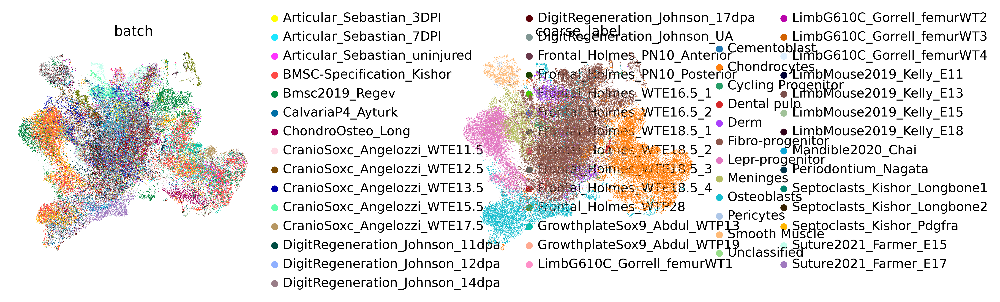

In [7]:
sc.pl.umap(reference_latent,
    color=['batch', 'coarse_label'],
    frameon=False,
    wspace=0.6
    )

/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3

Epoch 100/100: 100%|██████████| 100/100 [22:07<00:00, 13.23s/it, loss=673, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 100/100: 100%|██████████| 100/100 [22:07<00:00, 13.28s/it, loss=673, v_num=1]


/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(


INFO     Training for 50 epochs.                                                                                   


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3080') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 50/50: 100%|██████████| 50/50 [32:59<00:00, 40.27s/it, loss=684, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.


Epoch 50/50: 100%|██████████| 50/50 [32:59<00:00, 39.59s/it, loss=684, v_num=1]


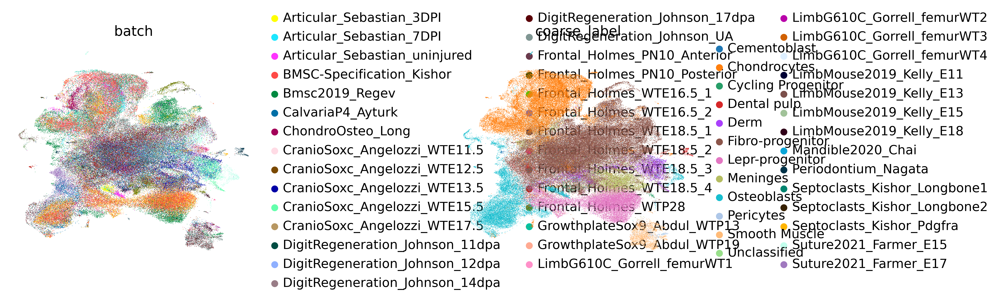

In [13]:

condition_key = 'batch'
cell_type_key = 'scanvi_label'
unlabeled_category = "unlabeled"
adata.X = adata.layers['counts']
adata.raw = adata
raw = adata.raw.to_adata()
raw.X = adata.layers['counts']
adata.raw = raw
sca.models.SCVI.setup_anndata(adata, batch_key=condition_key, labels_key=cell_type_key)
vae = sca.models.SCVI(
    adata,
    n_layers=2,
    encode_covariates=True,
    deeply_inject_covariates=False,
    use_layer_norm="both",
    use_batch_norm="none",n_hidden=256,dropout_rate=0.1,gene_likelihood="nb"
    )
vae.train(max_epochs=100)
scanvae = sca.models.SCANVI.from_scvi_model(vae, unlabeled_category ="Unkown")
scanvae.train(max_epochs=50)
reference_latent = sc.AnnData(scanvae.get_latent_representation())
reference_latent.obs["cell_type"] = adata.obs[cell_type_key].tolist()
reference_latent.obs["batch"] = adata.obs[condition_key].tolist()
reference_latent.obs["Project"] = adata.obs["Project"].tolist()
reference_latent.obs["coarse_label"] = adata.obs["coarse_label"].tolist()
sc.pp.neighbors(reference_latent, n_neighbors=8)
sc.tl.leiden(reference_latent)
sc.tl.umap(reference_latent)
sc.pl.umap(reference_latent,
    color=['batch', 'coarse_label'],
    frameon=False,
    wspace=0.6
    )


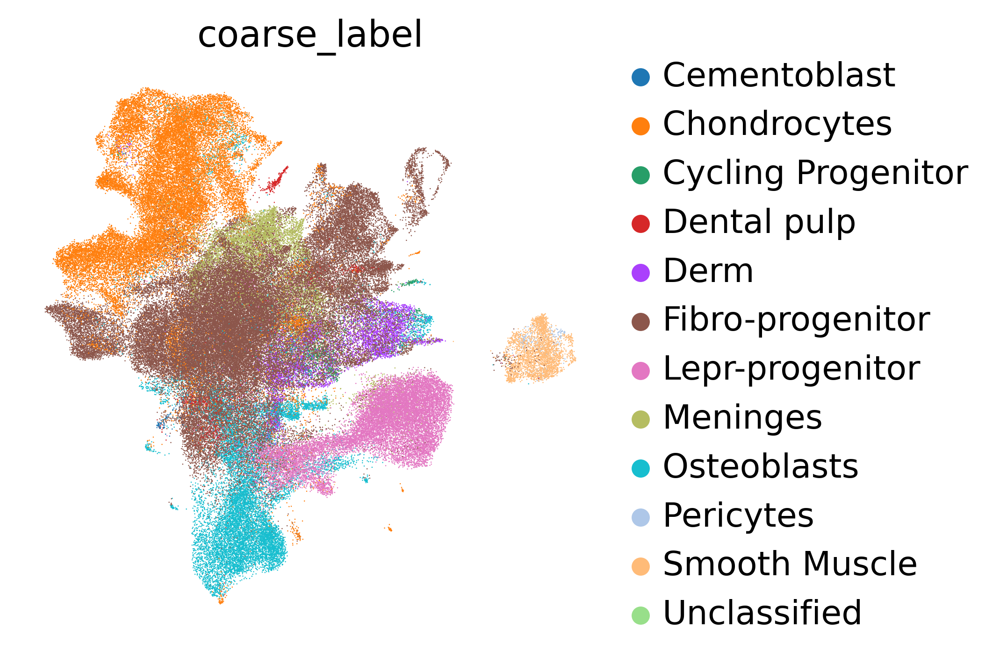

In [12]:
sc.pp.neighbors(reference_latent, n_neighbors=30)
sc.tl.leiden(reference_latent)
sc.tl.umap(reference_latent)
sc.pl.umap(reference_latent,
    color=['coarse_label'],
    frameon=False,
    wspace=0.6
    )


In [16]:
test=scanvae.get_normalized_expression(library_size=10e4)

In [18]:
test.to_csv("../data/scANVI_corrected.txt", sep='\t',index=True)

KeyboardInterrupt: 

In [19]:
normAnn=sc.AnnData(test)

In [21]:
normAnn.write_h5ad("../data/scANVI_corrected.h5ad")

In [9]:


condition_key = 'batch'
cell_type_key = 'scanvi_label'
unlabeled_category = "unlabeled"
hvg_n=3000
nlatent=30

In [7]:
sc.pp.highly_variable_genes(adata_whole, batch_key="batch",min_mean=0.035, flavor="cell_ranger",n_top_genes=hvg_n)
adata = adata_whole[:,adata_whole.var.highly_variable].copy()
adata.X = adata.layers['counts']
adata.raw = adata
raw = adata.raw.to_adata()
raw.X = adata.layers['counts']
adata.raw = raw

/home/zhangyufeng/.local/lib/python3.9/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(


In [ ]:

condition_key = 'batch'
cell_type_key = 'scanvi_label'
unlabeled_category = "unlabeled"
adata.X = adata.layers['counts']
adata.raw = adata
raw = adata.raw.to_adata()
raw.X = adata.layers['counts']
adata.raw = raw
sca.models.SCVI.setup_anndata(adata, batch_key=condition_key, labels_key=cell_type_key)
vae = sca.models.SCVI(
    adata,
    n_layers=2,
    n_latent=nlatent,
    encode_covariates=True,
    deeply_inject_covariates=False,
    use_layer_norm="both",
    use_batch_norm="none",n_hidden=256,dropout_rate=0.1,gene_likelihood="nb"
    )
vae.train(max_epochs=100)
scanvae = sca.models.SCANVI.from_scvi_model(vae, unlabeled_category ="Unkown")
scanvae.train(max_epochs=50)
reference_latent = sc.AnnData(scanvae.get_latent_representation())
reference_latent.obs["cell_type"] = adata.obs[cell_type_key].tolist()
reference_latent.obs["batch"] = adata.obs[condition_key].tolist()
reference_latent.obs["Project"] = adata.obs["Project"].tolist()
reference_latent.obs["coarse_label"] = adata.obs["coarse_label"].tolist()
sc.pp.neighbors(reference_latent, n_neighbors=8)
sc.tl.leiden(reference_latent)
sc.tl.umap(reference_latent)
sc.pl.umap(reference_latent,
    color=['batch', 'coarse_label'],
    frameon=False,
    wspace=0.6
    )


/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(
/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3

Epoch 100/100: 100%|██████████| 100/100 [24:22<00:00, 13.62s/it, loss=915, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 100/100: 100%|██████████| 100/100 [24:22<00:00, 14.63s/it, loss=915, v_num=1]


/home/zhangyufeng/miniconda3/envs/py3/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(


INFO     Training for 50 epochs.                                                                                   


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:lightning_fabric.accelerators.cuda:You are using a CUDA device ('NVIDIA GeForce RTX 3080') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 29/50:  56%|█████▌    | 28/50 [19:36<15:12, 41.46s/it, loss=916, v_num=1]

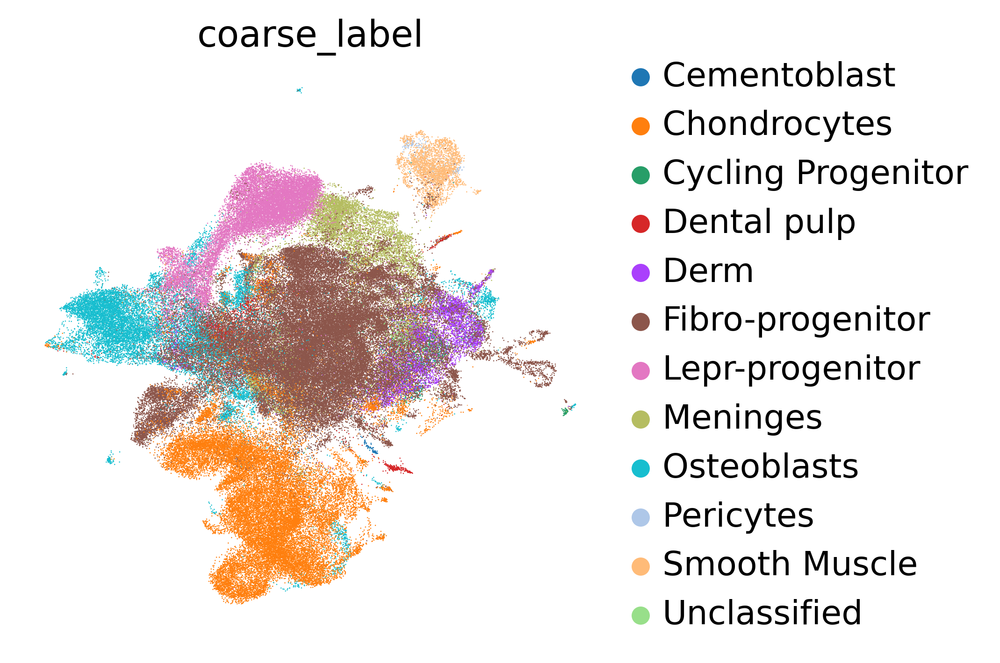

In [13]:
sc.pl.umap(reference_latent,
    color=['coarse_label'],
    frameon=False,
    wspace=0.6
    )

In [14]:
ref_path = '../data/ref_model'
scanvae.save(ref_path, overwrite=True)


In [15]:
reference_latent.write_h5ad("../hypertune/3000_30_ref.h5ad")

In [24]:
adata=sc.read("../data/2.1_osteoMerge_SCRAN_log1p_gene_filtered.h5ad")

In [25]:
adata.obsm=reference_latent.obsm

In [28]:
adata_whole.obsm=reference_latent.obsm

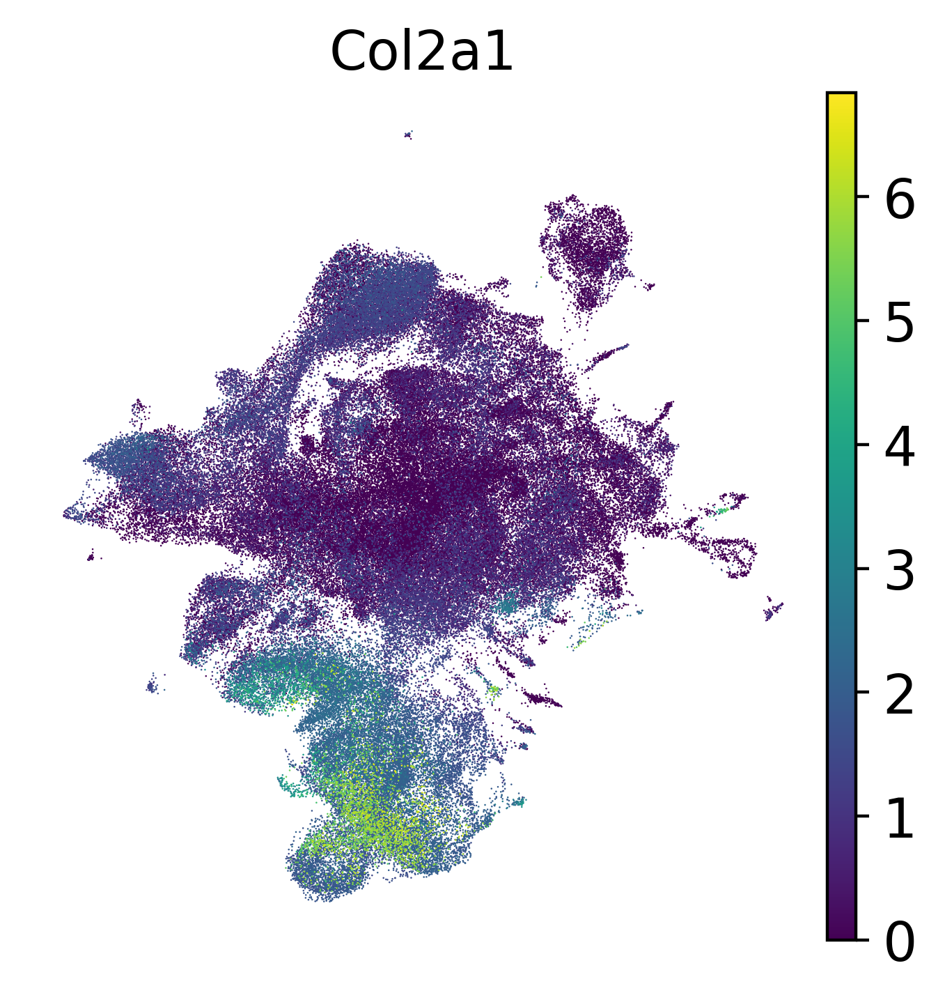

In [31]:
sc.pl.umap(adata_whole,
    color="Col2a1",
    frameon=False,
    wspace=0.6
    )


In [32]:


condition_key = 'batch'
cell_type_key = 'scanvi_label'
unlabeled_category = "unlabeled"
hvg_n=2000
nlatent=10

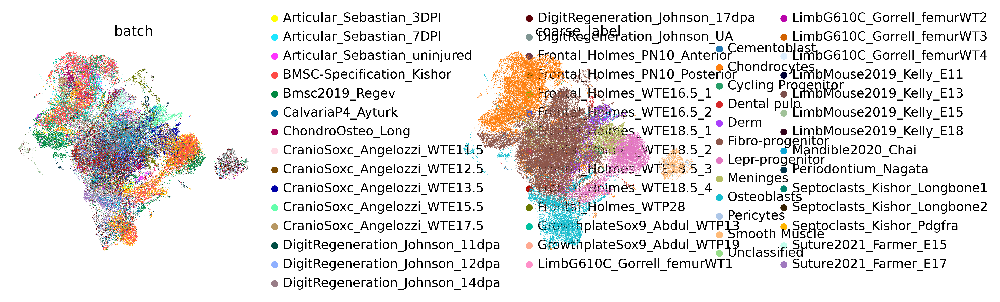

In [37]:
sc.pl.umap(reference_latent,
    color=['batch', 'coarse_label'],
    frameon=False,
    wspace=0.6
    )
